In [1]:
# common dependencies
import os
import warnings
import logging
from typing import Any, Dict, List, Union, Optional

# this has to be set before importing tensorflow
os.environ["TF_USE_LEGACY_KERAS"] = "1"

# pylint: disable=wrong-import-position

# 3rd party dependencies
import numpy as np
import pandas as pd
import tensorflow as tf

# package dependencies
from deepface.commons import package_utils, folder_utils
from deepface.commons.logger import Logger
from deepface.modules import (
    modeling,
    representation,
    verification,
    recognition,
    demography,
    detection,
    streaming,
    preprocessing,
)

import webcam as video
import phone as phone
import files as files

from deepface import __version__

logger = Logger()

In [2]:
def fromfiles(
    db_path: str,
    source_dir: str,
    dest_dir: str,
    model_name: str = "VGG-Face",
    detector_backend: str = "opencv",
    distance_metric: str = "cosine",
    enable_face_analysis: bool = True,
    anti_spoofing: bool = False,
) -> None:
    """
    Run real time face recognition and facial attribute analysis

    Args:
        db_path (string): Path to the folder containing image files. All detected faces
            in the database will be considered in the decision-making process.

        model_name (str): Model for face recognition. Options: VGG-Face, Facenet, Facenet512,
            OpenFace, DeepFace, DeepID, Dlib, ArcFace, SFace and GhostFaceNet (default is VGG-Face).

        detector_backend (string): face detector backend. Options: 'opencv', 'retinaface',
            'mtcnn', 'ssd', 'dlib', 'mediapipe', 'yolov8', 'centerface' or 'skip'
            (default is opencv).

        distance_metric (string): Metric for measuring similarity. Options: 'cosine',
            'euclidean', 'euclidean_l2' (default is cosine).

        enable_face_analysis (bool): Flag to enable face analysis (default is True).

        source (Any): The source for the video stream (default is 0, which represents the
            default camera).

        time_threshold (int): The time threshold (in seconds) for face recognition (default is 5).

        frame_threshold (int): The frame threshold for face recognition (default is 5).

        anti_spoofing (boolean): Flag to enable anti spoofing (default is False).
    Returns:
        None
    """

    print("Indexing "+db_path)

    files.analysis(
        db_path=db_path,
        source_dir=source_dir,
        dest_dir=dest_dir,
        model_name=model_name,
        detector_backend=detector_backend,
        distance_metric=distance_metric,
        enable_face_analysis=enable_face_analysis,
        anti_spoofing=anti_spoofing,
    ) 


In [3]:
db_path="face-db"
source_path="result/test1"
dest_path="result/result1"

In [4]:
fromfiles(db_path=db_path, source_dir=source_path, dest_dir=dest_path, enable_face_analysis=False, model_name="ArcFace", detector_backend="retinaface", anti_spoofing=False)

Indexing face-db
Indexing database face-db
24-08-14 18:18:15 - ArcFace is built
24-08-14 18:18:20 - Hello, face-db\B2110011\z5717853953668_17bb8b4649b7cdd4f6d0642fb23ad11d.jpg
Files in source directory: result/test1
42b9a1113b269f78c6374.jpg
495c85ad1f9abbc4e28b11.jpg
5cd02928b31f17414e0e13.jpg
608090cc9fde3b8062cf.jpg
80e834eba0dc04825dcd5.jpg
b688b78123b687e8dea76.jpg
b6d87609ec3e4860112f14.jpg
dfec701cea2b4e75173a12.jpg
z5717486892817_1cb9bffd9d74a852bd459b5a4a34ec93.jpg
z5717504504105_db78a0d3b5a30903544986ef87189f27.jpg
24-08-14 18:18:30 - Hello, face-db\B2111989\z5717849461794_9f2461434a268f83bfed73a43ce4a44a.jpg
face-db\B2111989\z5717849461794_9f2461434a268f83bfed73a43ce4a44a.jpg 940 725 232 325 True 0
Label 'B2111989' và thời gian '2024-08-14 18:18:33' đã được ghi vào attendance.xlsx trong sheet 'Sheet'.
24-08-14 18:18:35 - Hello, face-db\B2111959\z5717862071488_98d00f8d5802e2ad79bd07eac87a521e.jpg
face-db\B2111959\z5717862071488_98d00f8d5802e2ad79bd07eac87a521e.jpg 577 610 168

In [5]:
import cv2
import matplotlib.pyplot as plt
from deepface import DeepFace
import pandas as pd
import os

In [6]:
# img_path = "result/result1/z5717486892817_1cb9bffd9d74a852bd459b5a4a34ec93.jpg"
# img = cv2.imread(img_path)

In [7]:
# plt.figure(figsize = (20,20))
# plt.imshow(img[:, :, ::-1])
# plt.show()

In [8]:
# import openpyxl
# from datetime import datetime
# import os

# # Đường dẫn tới tệp Excel
# excel_file_path = 'attendance.xlsx'

# def mark_attendance(label: str, file_path: str = excel_file_path, sheet_name: str = 'M01'):
#     """
#     Ghi tên label và thời gian hiện tại vào file Excel.
#     Args:
#         label (str): Tên label cần ghi.
#         file_path (str): Đường dẫn đến file Excel (mặc định là 'attendance.xlsx').
#         sheet_name (str): Tên sheet cần ghi (mặc định là 'Sheet').
#     """
#     try:
#         # Mở hoặc tạo mới workbook
#         workbook = openpyxl.load_workbook(file_path) if os.path.exists(file_path) else openpyxl.Workbook()

#         # Chọn hoặc tạo sheet
#         if sheet_name in workbook.sheetnames:
#             sheet = workbook[sheet_name]
#         else:
#             sheet = workbook.create_sheet(sheet_name)

#         # Lấy thời gian hiện tại
#         time_now = datetime.now().strftime('%Y-%m-%d %H:%M:%S')

#         # Ghi label vào cột A và thời gian vào cột B của dòng tiếp theo
#         next_row = sheet.max_row + 1
#         sheet.cell(row=next_row, column=1, value=label)
#         sheet.cell(row=next_row, column=2, value=time_now)

#         # Lưu workbook
#         workbook.save(file_path)
#         print(f"Label '{label}' và thời gian '{time_now}' đã được ghi vào {file_path} trong sheet '{sheet_name}'.")

#     except Exception as e:
#         print(f"Không thể ghi label vào file Excel. Lỗi: {str(e)}")

# # Ví dụ sử dụng
# mark_attendance('B2105695')


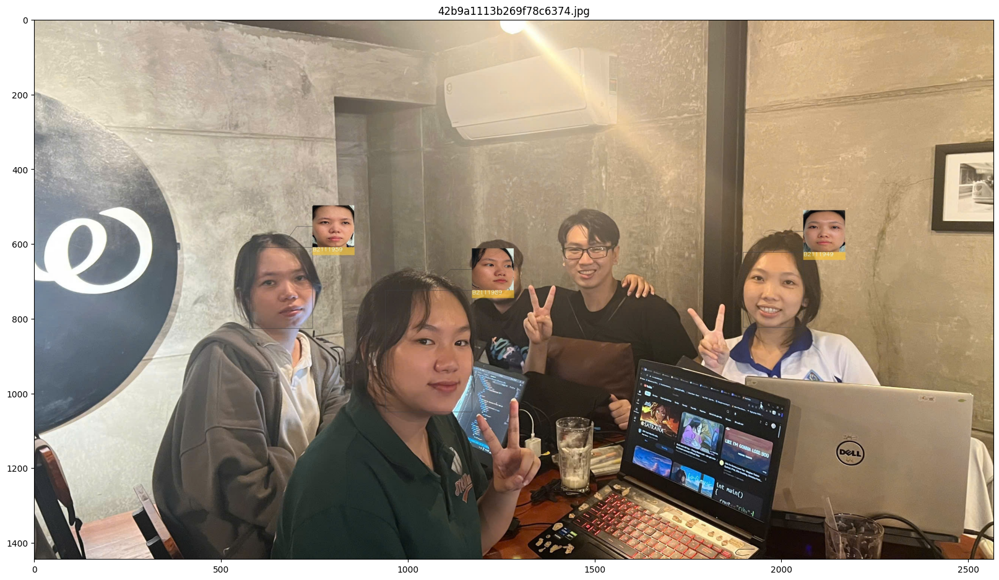

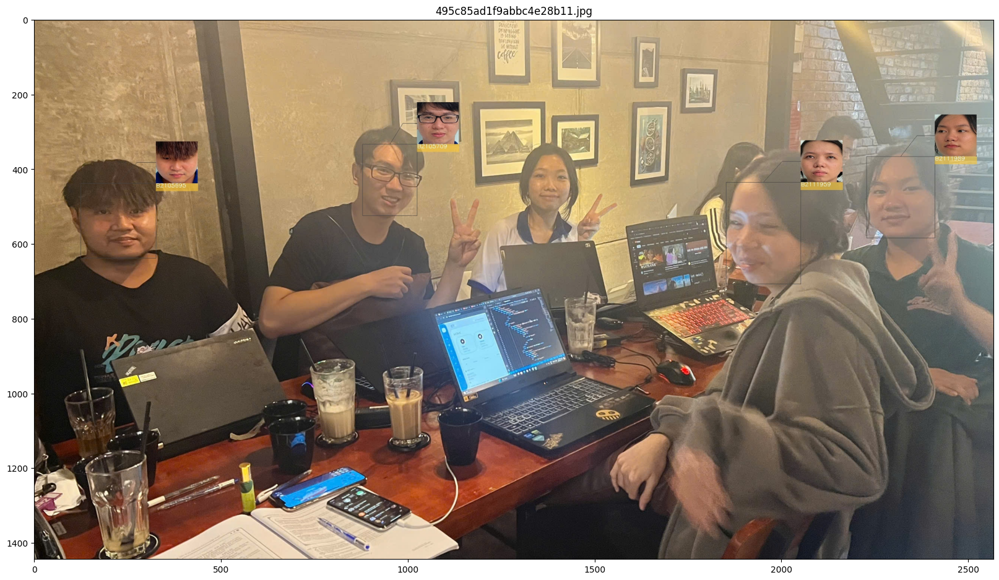

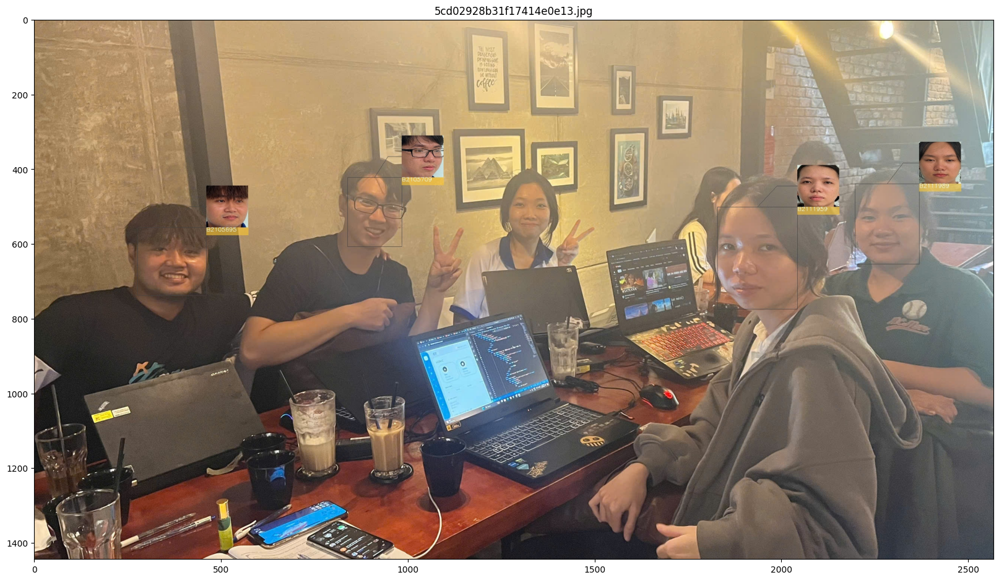

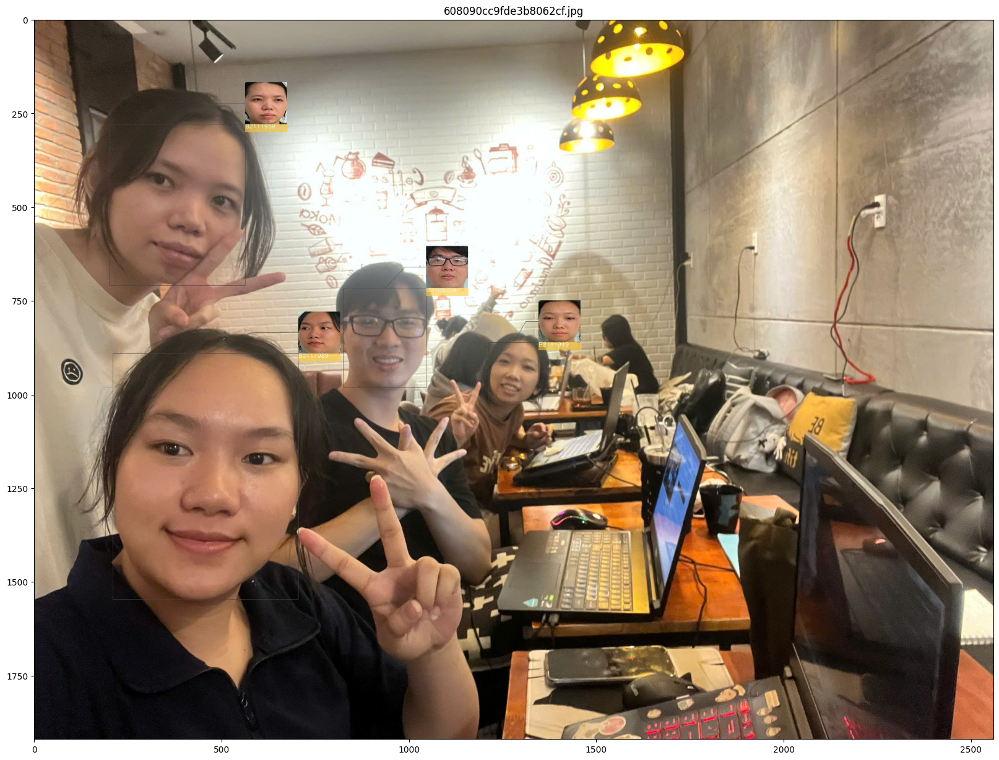

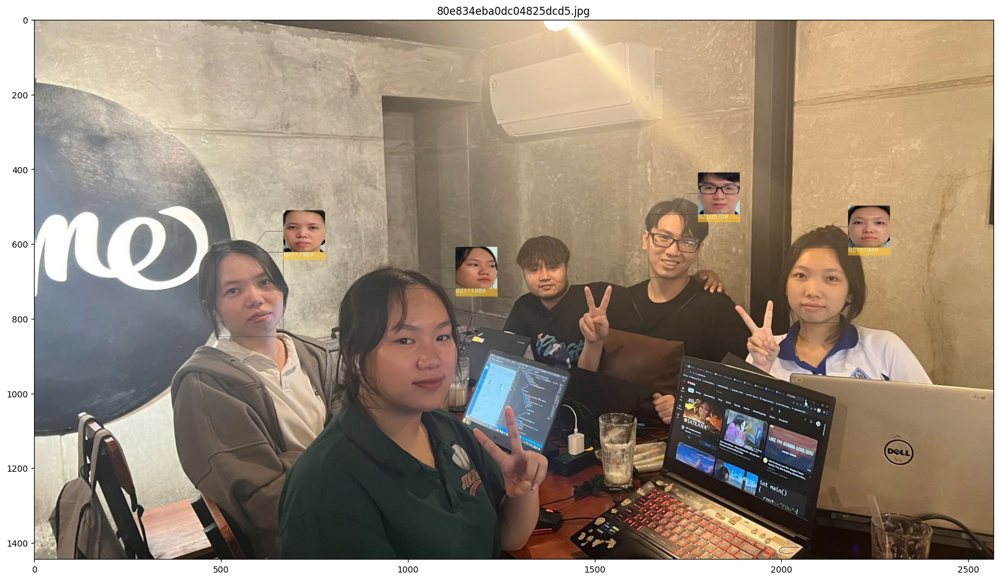

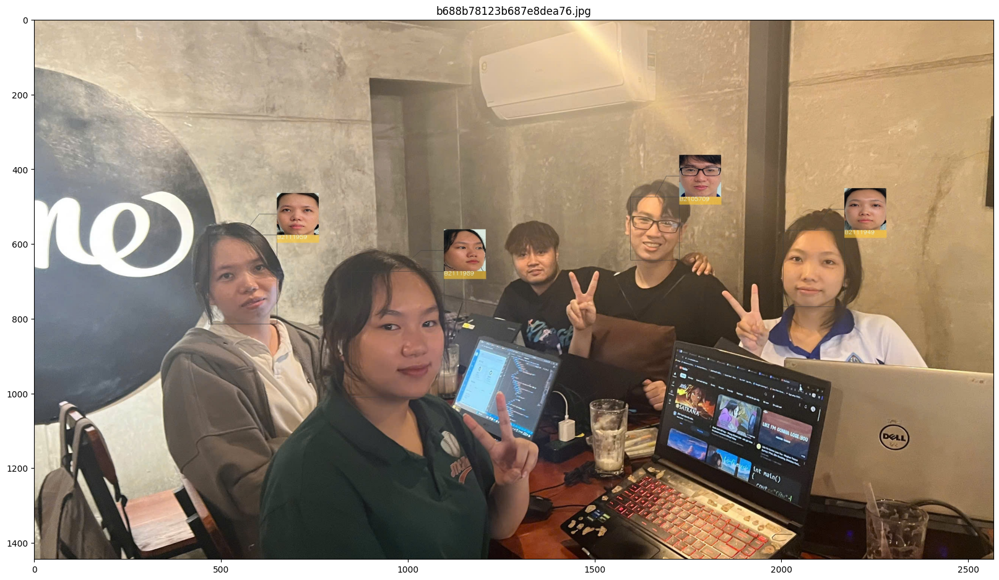

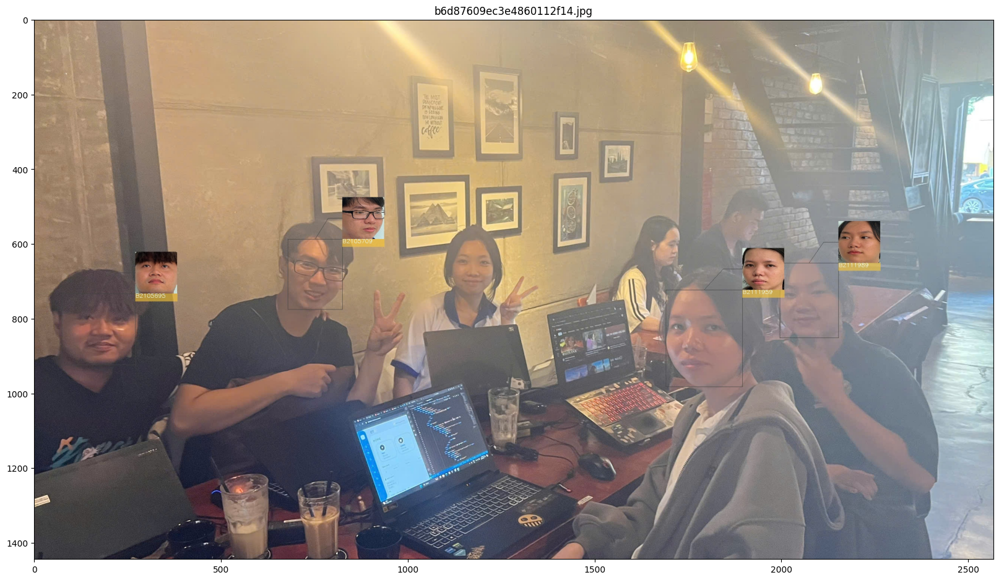

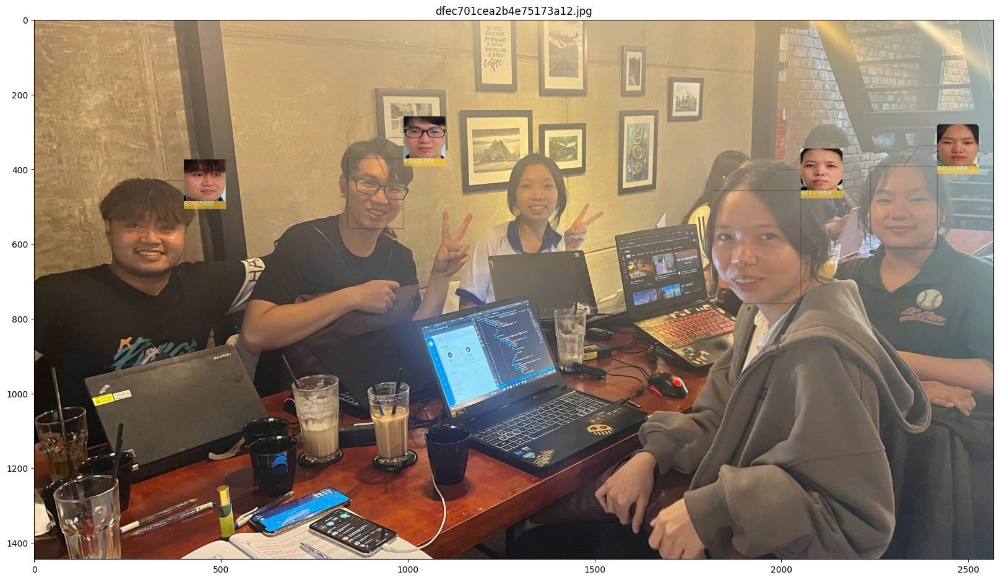

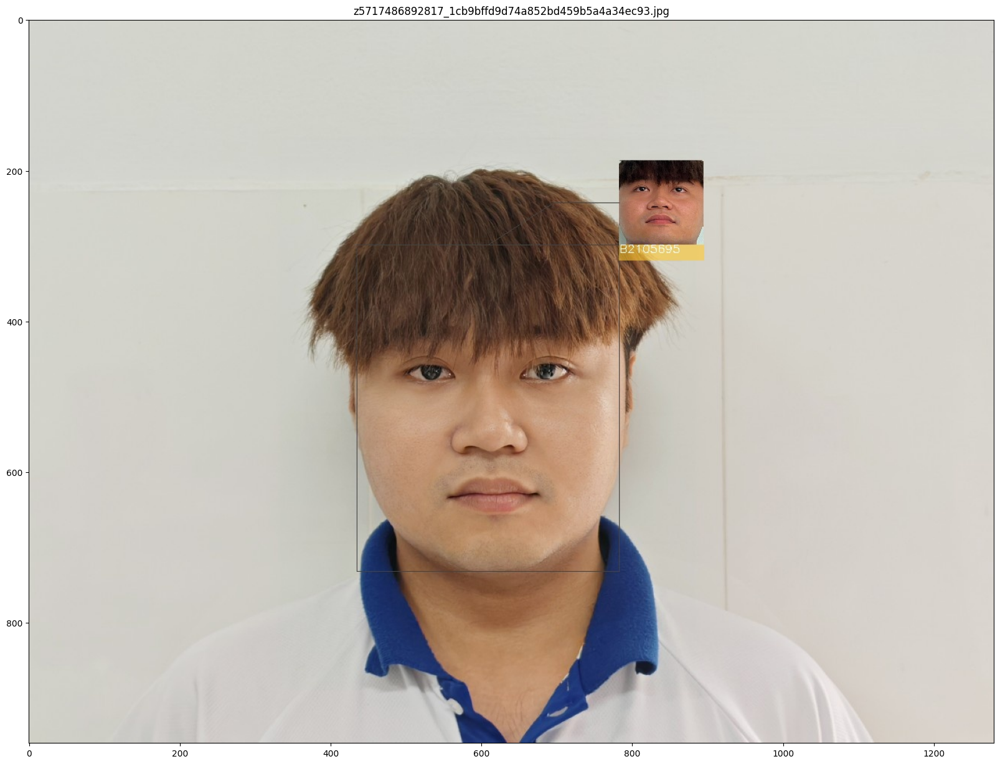

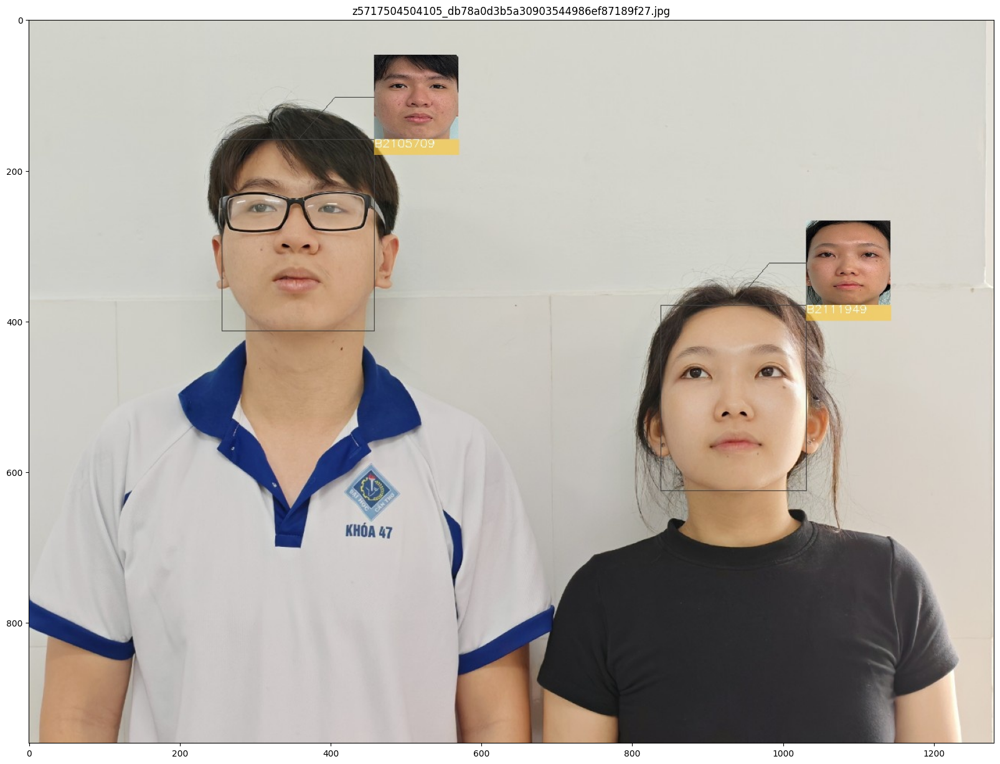

In [9]:
# Đường dẫn tới thư mục chứa hình ảnh
folder_path = "result/result1"

# Lấy danh sách tất cả các tệp trong thư mục
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Lặp qua từng tệp hình ảnh và hiển thị chúng
for image_file in image_files:
    img_path = os.path.join(folder_path, image_file)
    img = cv2.imread(img_path)
    
    # Hiển thị hình ảnh
    plt.figure(figsize=(20, 20))
    plt.imshow(img[:, :, ::-1])  # Chuyển từ BGR sang RGB
    plt.title(image_file)  # Hiển thị tên file ảnh
    plt.show()